<a href="https://colab.research.google.com/github/miktae/nckh_2023/blob/main/Measurement_OpenCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Set up the environment 

In [ ]:
!pip install opencv-python 
!pip install imutils
!pip install numpy 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Import the necessary packages

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import numpy as np
import argparse
import imutils
import cv2
from google.colab.patches import cv2_imshow

Define irate which is cm per pixel, midpoint function 

In [ ]:
# cm per pixel
irate = 0.025

def midpoint(ptA, ptB):
	return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

Construct the argument parse and parse the arguments

Load the image, convert it to grayscale, and blur it slightly
// image = cv2.imread(args["image"])

In [ ]:
image = cv2.imread("./assets/test.jpg")


Scale the image

In [ ]:
scale_percent = 100 # percent of original size
width = int(image.shape[1] * scale_percent / 100)
height = int(image.shape[0] * scale_percent / 100)
dim = (width, height) #px
print(dim)

(2560, 1832)


Change the image to grayscale and blur it to be more slight

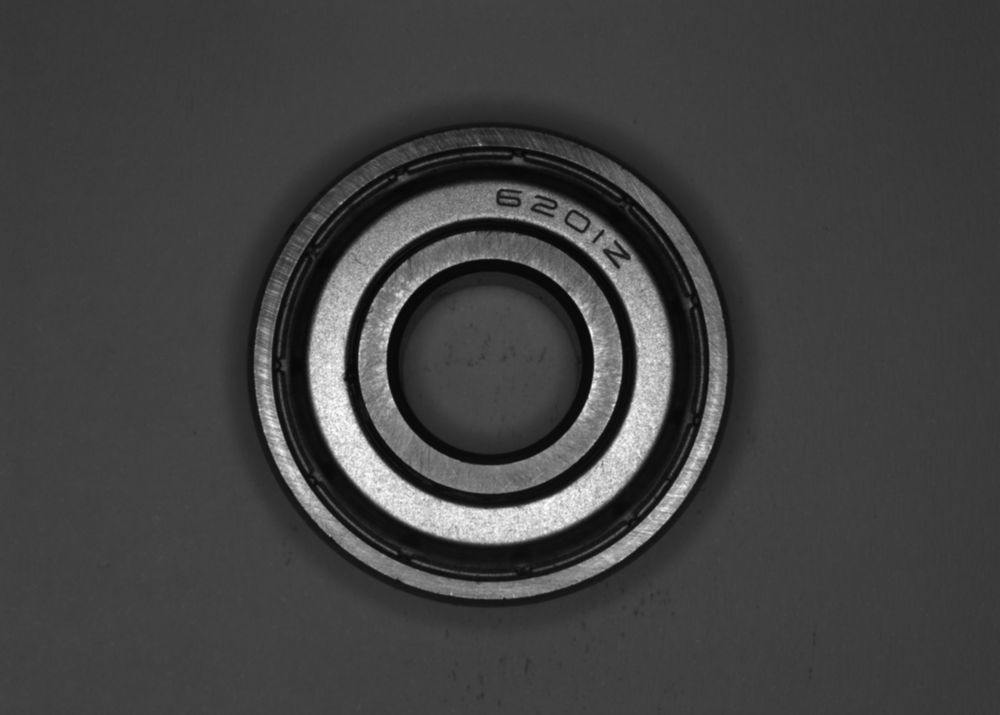

In [ ]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
gray = cv2.GaussianBlur(gray, (7, 7), 0)
cv2_imshow(cv2.resize(gray, dim, interpolation = cv2.INTER_AREA))

Perform edge detection, then perform a dilation and erosion to , close gaps in between object edges

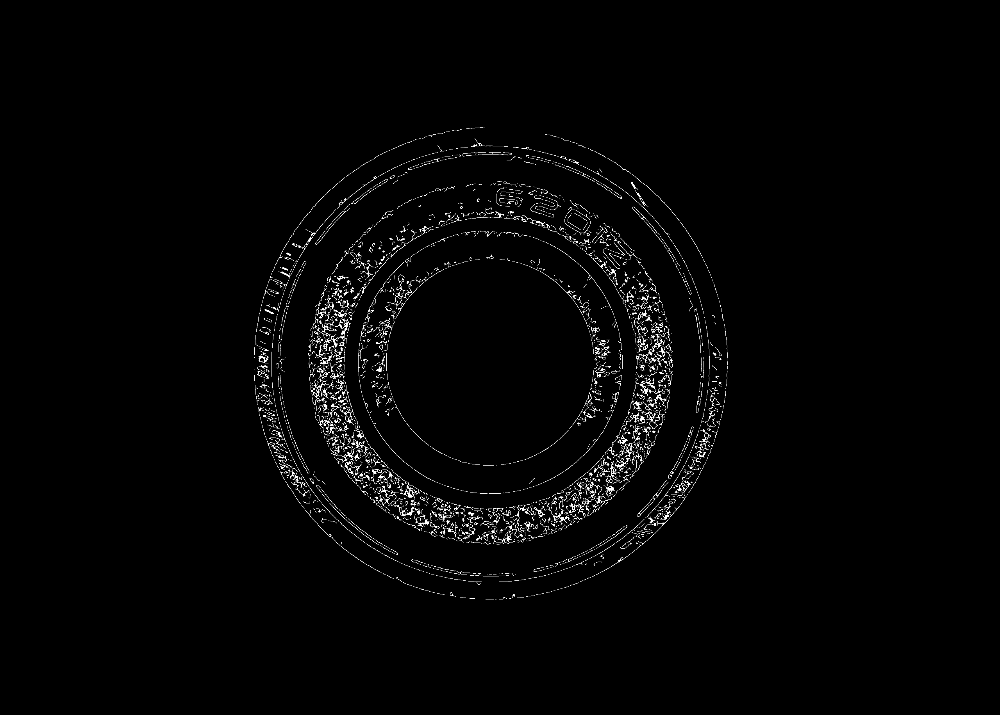

In [ ]:
edged = cv2.Canny(gray, 50, 100)
edged = cv2.dilate(edged, None, iterations=1)
edged = cv2.erode(edged, None, iterations=1)
cv2_imshow(cv2.resize(edged, dim, interpolation = cv2.INTER_AREA))

Find contours in the edge map

In [ ]:
cnts = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL,
	cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

Sort the contours from left-to-right and initialize them

In [ ]:
(cnts, _) = contours.sort_contours(cnts)

Draw and calculate radius

In [ ]:
def draw_radius(image, x_center, y_center):
	edged_arr = []

	# radius
	for i in range(x_center, width):
		if edged[225, i] == 255:
			edged_arr.append(i)
	# print(edged_arr)
  # Check detect contours
	if len(edged_arr) > 0:
		inside_radius = int(edged_arr[0] - x_center)
		print(inside_radius)#px
		outside_radius = int(edged_arr[len(edged_arr)-1] - x_center)
		print(inside_radius * irate, outside_radius * irate)#cm
		cv2.circle(image, (x_center, y_center), inside_radius, (255,255,255))
		cv2.circle(image, (x_center, y_center), outside_radius, (255,255,255))
    # Angle to draw
		angle_degrees = -45
		angle_radians = np.deg2rad(angle_degrees)
		x_endpoint = int(x_center + outside_radius * np.cos(angle_radians))
		y_endpoint = int(y_center + outside_radius * np.sin(angle_radians))
		
		cv2.line(image, (x_center, y_center),(edged_arr[0], y_center), (255, 0, 0), 3)
		cv2.line(image, (x_center, y_center),(x_endpoint, y_endpoint), (255, 0, 255), 3)
		cv2.putText(image, "R in: {:.1f}cm".format(inside_radius * irate),
			(10, 30), cv2.FONT_HERSHEY_SIMPLEX,
			1, (255, 255, 255), 1)
		cv2.putText(image, "R out: {:.1f}cm".format(outside_radius * irate),
			(10, 60), cv2.FONT_HERSHEY_SIMPLEX,
			1, (255, 255, 255), 1)
	else:
		print("Error: not detected")

Loop over the contours individually

Error: not detected


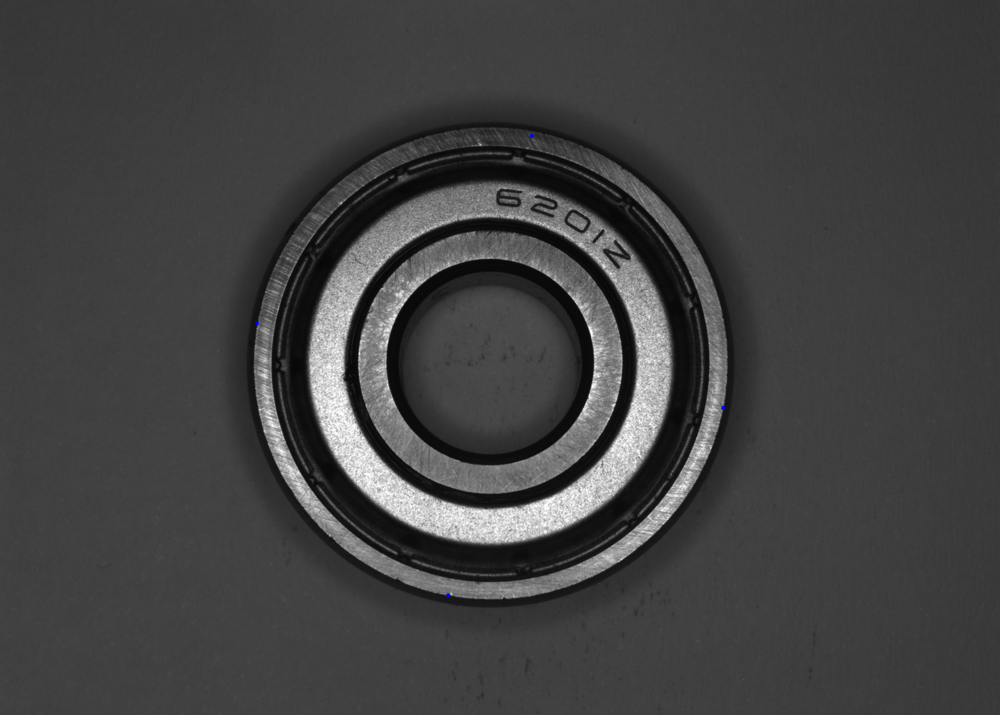

Error: not detected


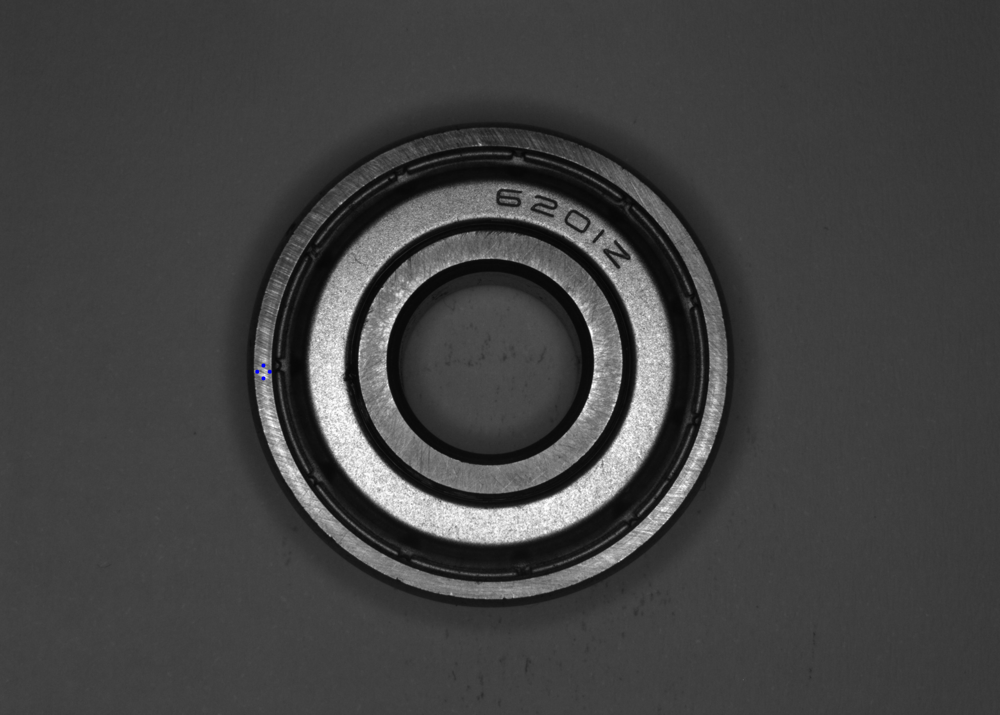

Error: not detected


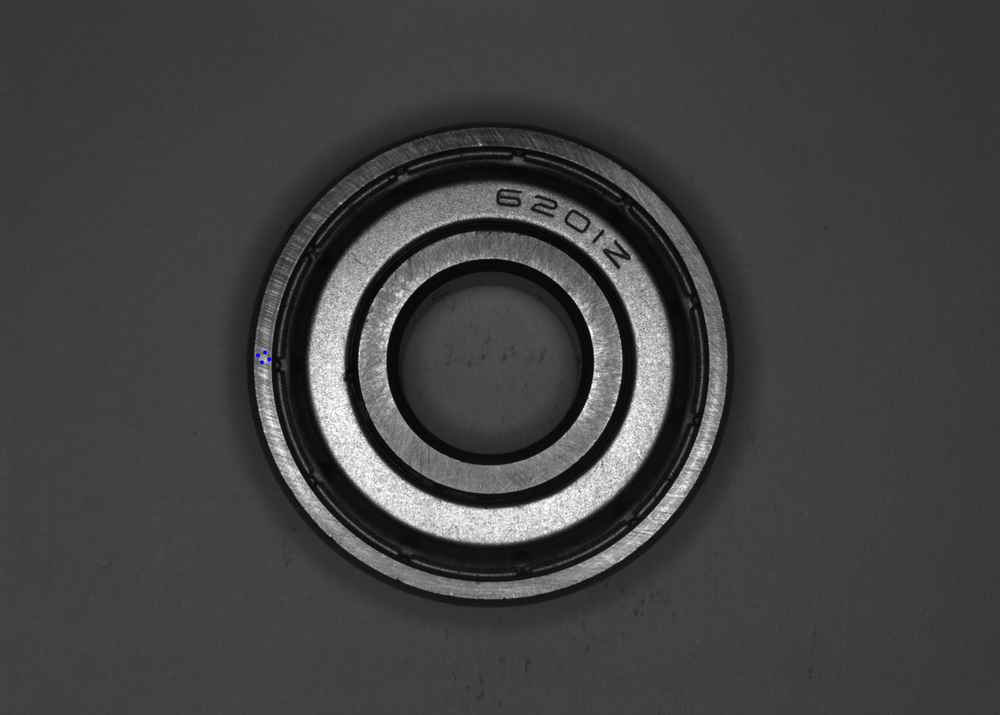

Error: not detected


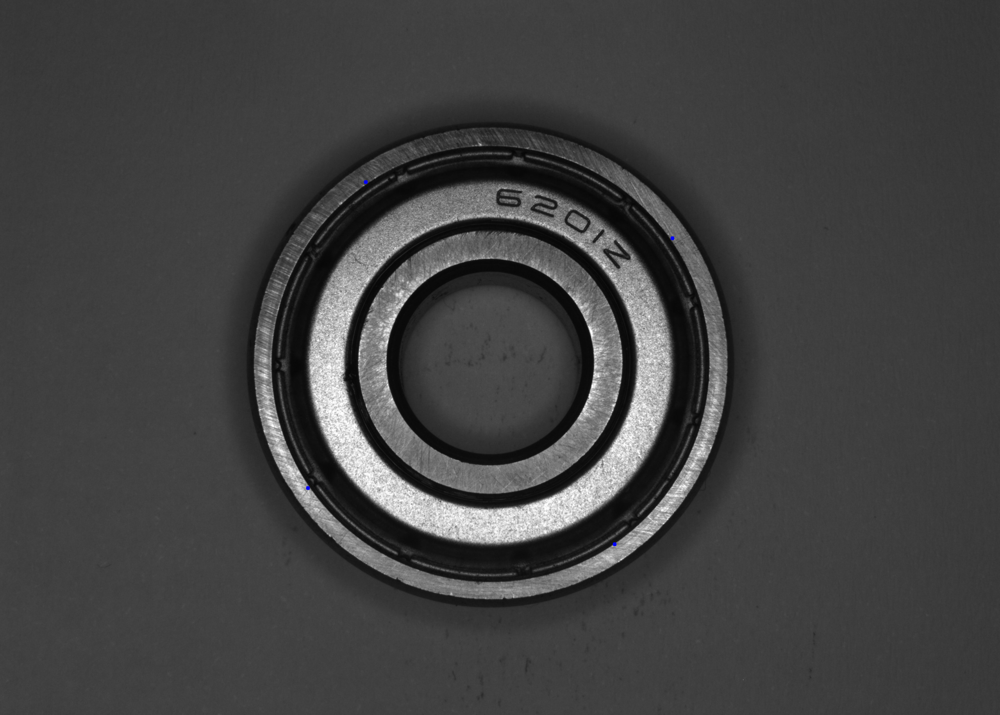

Error: not detected


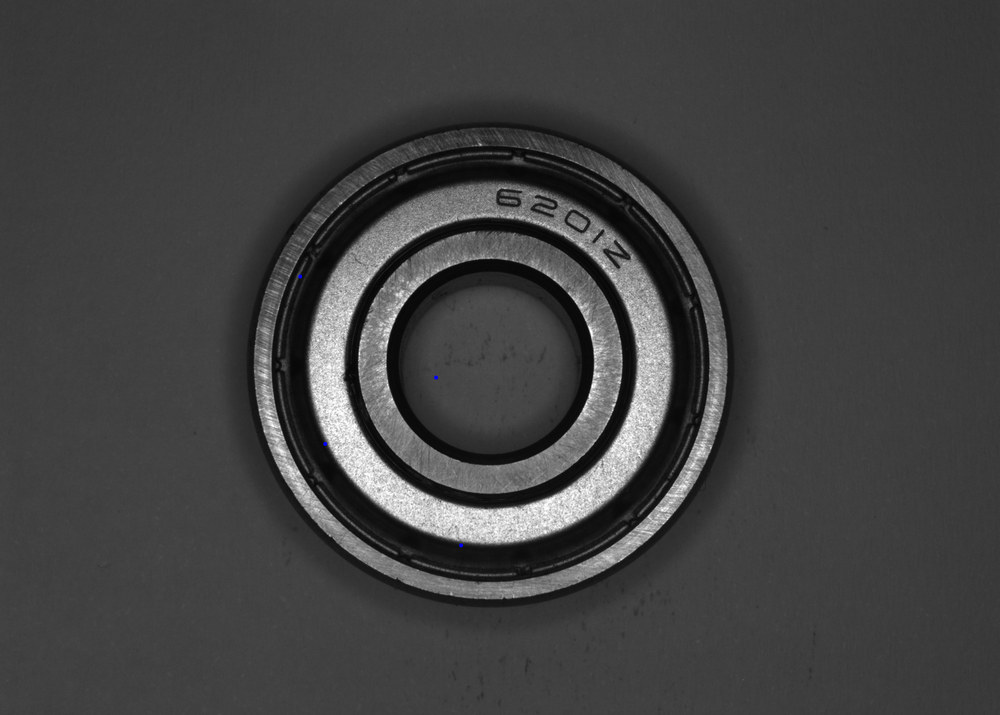

Error: not detected


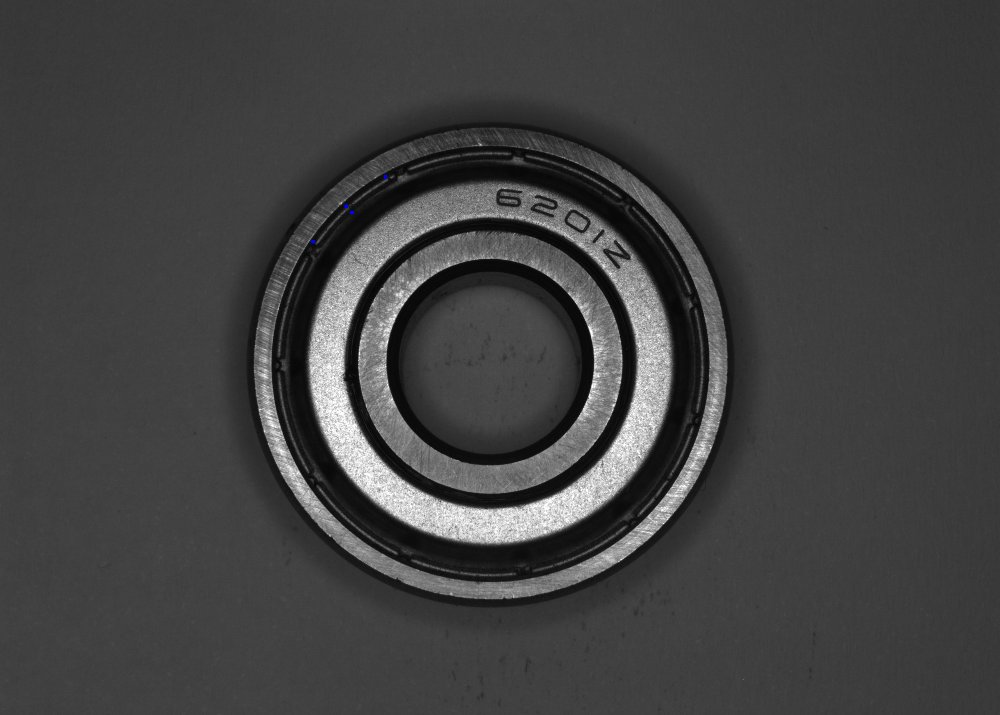

Error: not detected


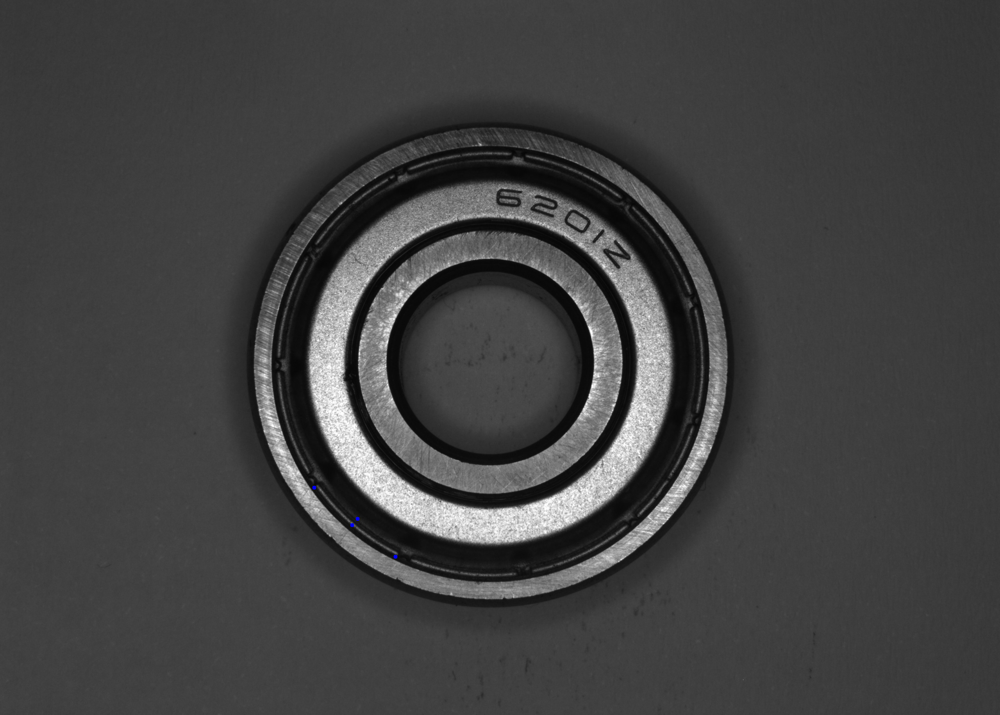

Error: not detected


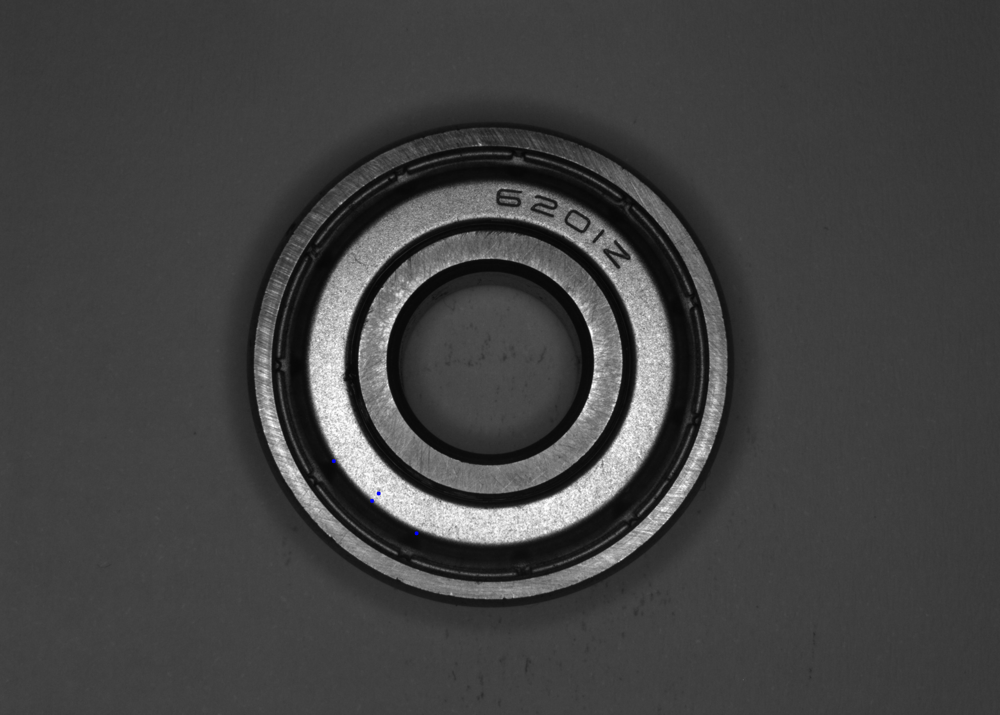

Error: not detected


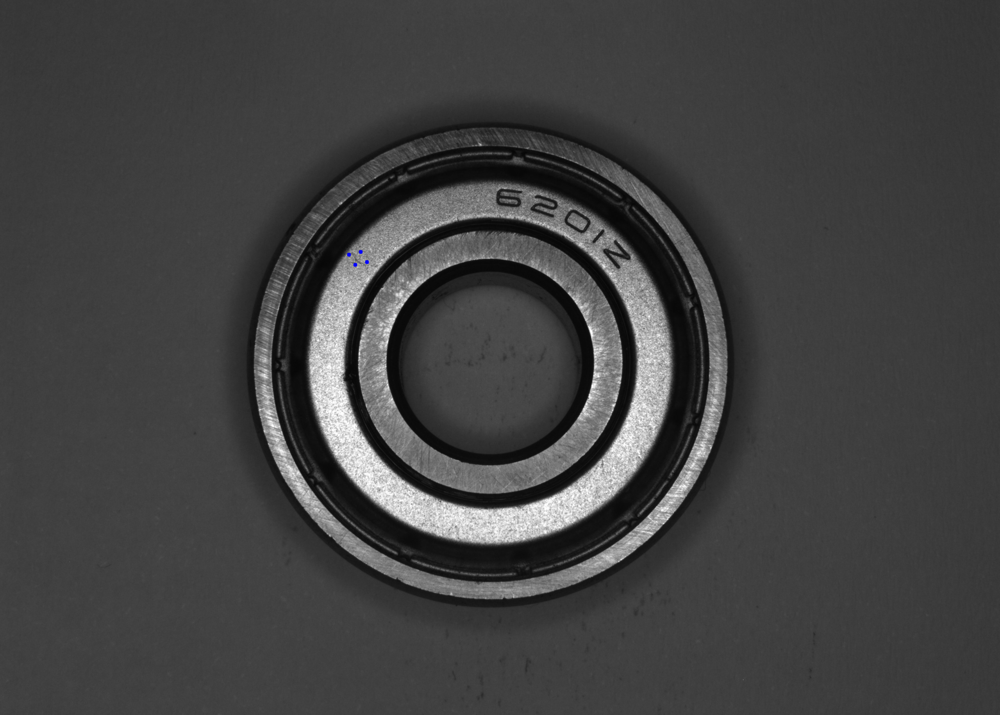

Error: not detected


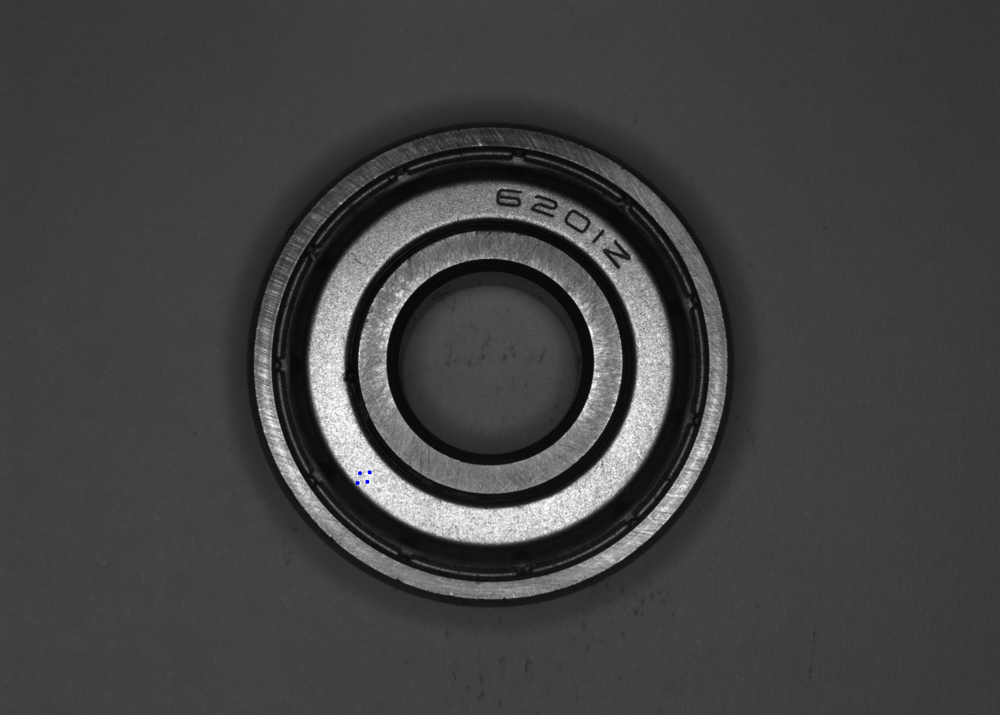

Error: not detected


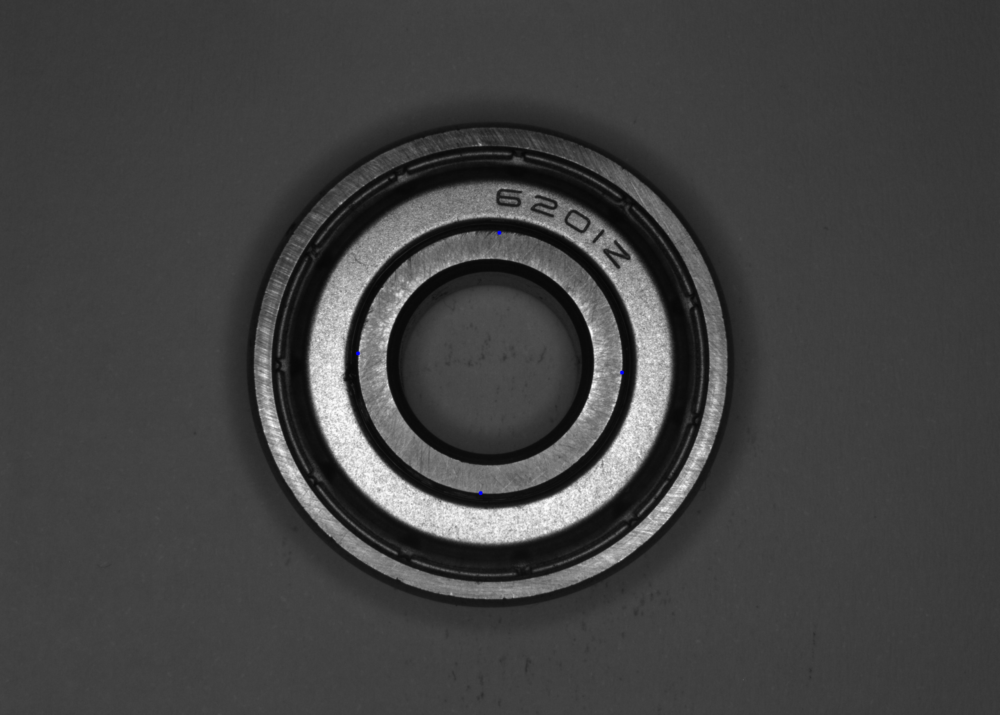

Error: not detected


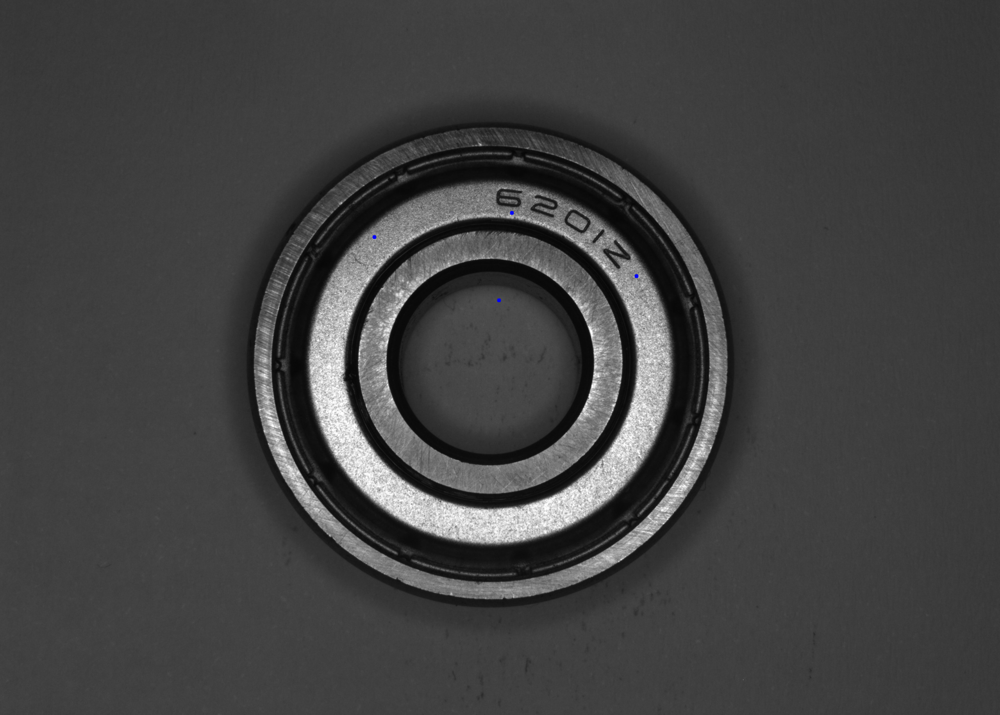

Error: not detected


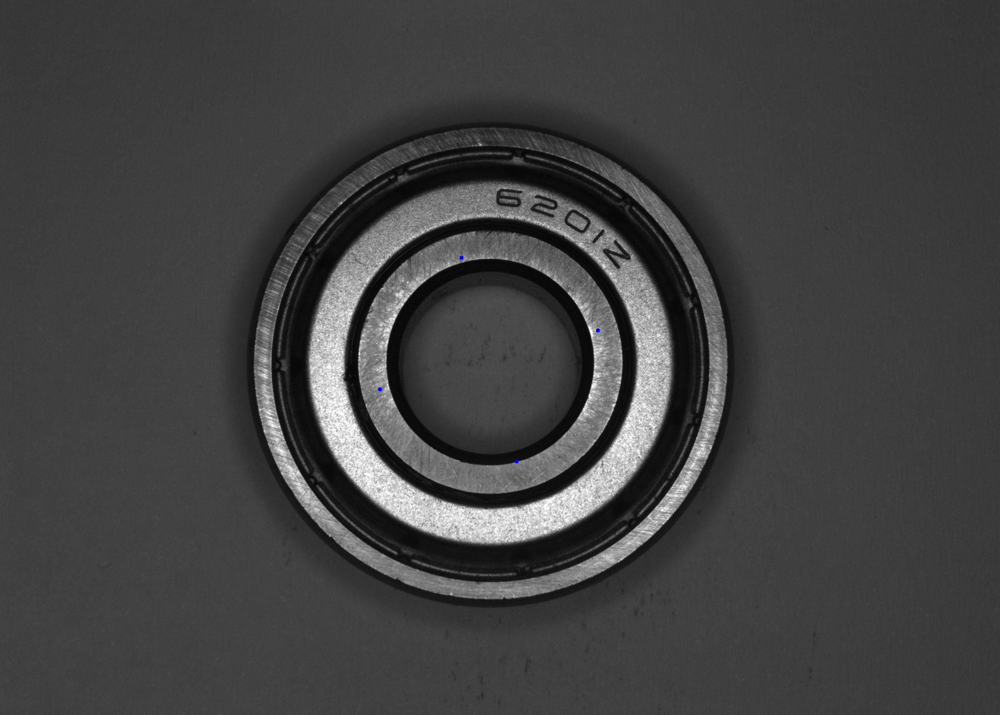

Error: not detected


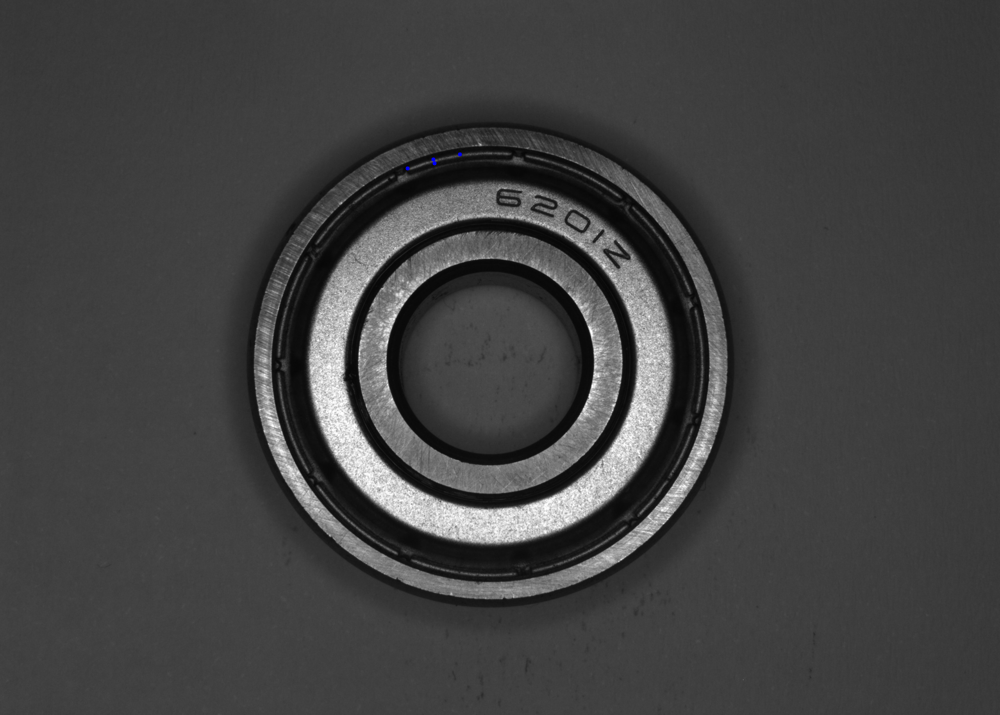

Error: not detected
Buffered data was truncated after reaching the output size limit.

In [ ]:
for c in cnts:
	# if the contour is not sufficiently large, ignore it
	if cv2.contourArea(c) < 200:
		continue
	# compute the rotated bounding box of the contour
	orig = image.copy()
	box = cv2.minAreaRect(c)
	(x_r, y_r), radius = cv2.minEnclosingCircle(c)
	center = (int(x_r), int(y_r))
	radius = int(radius)
	# print("R = ", radius)
	# print(center)
	draw_radius(orig, int(x_r), int(y_r))

	box = cv2.cv.BoxPoints(box) if imutils.is_cv2() else cv2.boxPoints(box)
	box = np.array(box, dtype="int")
	# order the points in the contour such that they appear
	# in top-left, top-right, bottom-right, and bottom-left
	# order, then draw the outline of the rotated bounding
	# box
	box = perspective.order_points(box)
	# cv2.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
	# loop over the original points and draw them
  # for (x, y) in box:
  #  cv2.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)
# unpack the ordered bounding box, then compute the midpoint
	# between the top-left and top-right coordinates, followed by
	# the midpoint between bottom-left and bottom-right coordinates
	(tl, tr, br, bl) = box
	(tltrX, tltrY) = midpoint(tl, tr)
	(blbrX, blbrY) = midpoint(bl, br)
	# compute the midpoint between the top-left and top-right points,
	# followed by the midpoint between the top-righ and bottom-right
	(tlblX, tlblY) = midpoint(tl, bl)
	(trbrX, trbrY) = midpoint(tr, br)
# compute the Euclidean distance between the midpoints
	dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
	dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))

	# draw the midpoints on the image
	cv2.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
	cv2.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
	cv2.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
	cv2.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
	cv2_imshow(cv2.resize(orig, dim, interpolation = cv2.INTER_AREA))
	cv2.waitKey(0)